<a href="https://colab.research.google.com/github/nouramnif/Analyzing-COVID-related-misinformation-on-Twitter---emotion-vs-veracity-/blob/main/project_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 52.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 57.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.4/182.4 KB 6.5 MB/s eta 0:00:00


#Importing libraries

In [ ]:
#importing libraries
import torch
import torch.nn as nn
import transformers
from transformers import BertModel, BertTokenizer, AdamW, get_linear_schedule_with_warmup
from torch.utils.data import Dataset, DataLoader
import numpy as np
import pandas as pd
import string
import re 
import nltk
from wordcloud import WordCloud, STOPWORDS , ImageColorGenerator
import matplotlib.pyplot as plt
from collections import Counter
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from collections import defaultdict
from sklearn.metrics import classification_report
import torch.nn.functional as F
import plotly.express as px

In [ ]:
import warnings
warnings.filterwarnings('ignore')

#Importing data

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving stance-detection-in-covid-19-tweets (1).csv to stance-detection-in-covid-19-tweets (1).csv


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving COVIDSenti (1).csv to COVIDSenti (1).csv


In [ ]:
from google.colab import files
uploaded = files.upload()

Saving twitter-emotion.csv to twitter-emotion.csv


In [ ]:
df = pd.read_csv("stance-detection-in-covid-19-tweets (1).csv")
df_rostom= pd.read_csv("twitter-emotion.csv")
df_abhishek= pd.read_csv("COVIDSenti (1).csv")

In [ ]:
df

,Tweet Id,Target,Stance,Opinion Towards,Sentiment,tweet
0,1284304120514396160,stay_at_home_orders,FAVOR,2. The tweet does NOT expresses opinion about ...,neg,@nytimes We have descended into a species with...
1,1285810667728011264,stay_at_home_orders,FAVOR,1. The tweet explicitly expresses opinion abo...,pos,"Good morning fam, just an ernest appeal;\n 1. ..."
2,1244962763962814464,stay_at_home_orders,FAVOR,1. The tweet explicitly expresses opinion abo...,pos,Found a whole new meaning of BC - before coron...
3,1289723088133750784,stay_at_home_orders,FAVOR,1. The tweet explicitly expresses opinion abo...,pos,@MortonBalthus Thanks for following! #WritingC...
4,1289961106446802944,stay_at_home_orders,FAVOR,2. The tweet does NOT expresses opinion about ...,pos,@worldknowus @diprjk @kansalrohit69 @DrSyedSeh...
...,...,...,...,...,...,...
13948,1287514808955404288,school_closures,NONE,2. The tweet does NOT expresses opinion about ...,neg,@DeAnna4Congress @cathibrgnr58 Too bad these G...
13949,1287336010951532544,school_closures,NONE,2. The tweet does NOT expresses opinion about ...,pos,If teacher hardwork will not be evaluated than...
13950,1287329911204544512,school_closures,NONE,2. The tweet does NOT expresses opinion about ...,pos,We live in a world where digitalisation is the...
13951,1287721086210183168,school_closures,NONE,2. The tweet does NOT expresses opinion about ...,neg,@anubha1812 @HappyNGIS Everyone has to follow ...


In [ ]:
df['Target'].unique()

array(['stay_at_home_orders', 'fauci', 'face_masks', 'school_closures'],
      dtype=object)

# Data preprocessing
clean_text function  to clean the data by making the text lowercase, removing text in square brackets, removing links, punctuation and words that contain numbers

remove_emoji function to remove emoticons, symbols and flags.

remove all the stopwords.

In [ ]:
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def clean_text(text):
    '''Make text lowercase, remove text in square brackets,remove links,remove punctuation
    and remove words containing numbers.'''
    text = text.lower()
    text = re.sub('\[.*?\]', '', text)
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\n', '', text)
    text = re.sub('\w*\d\w*', '', text)
    return text

In [ ]:
def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)

In [ ]:
def remove_stopwords(text):
    """custom function to remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

In [ ]:
df['tweet'] = df['tweet'].apply(lambda x: remove_emoji(x))
df['tweet'] = df['tweet'].apply(lambda x: clean_text(x))
df['tweet'] = df['tweet'].apply(lambda x:remove_stopwords(x))

#Data visualisation 

**Word cloud of 100 most common words in each stance**

(-0.5, 399.5, 199.5, -0.5)

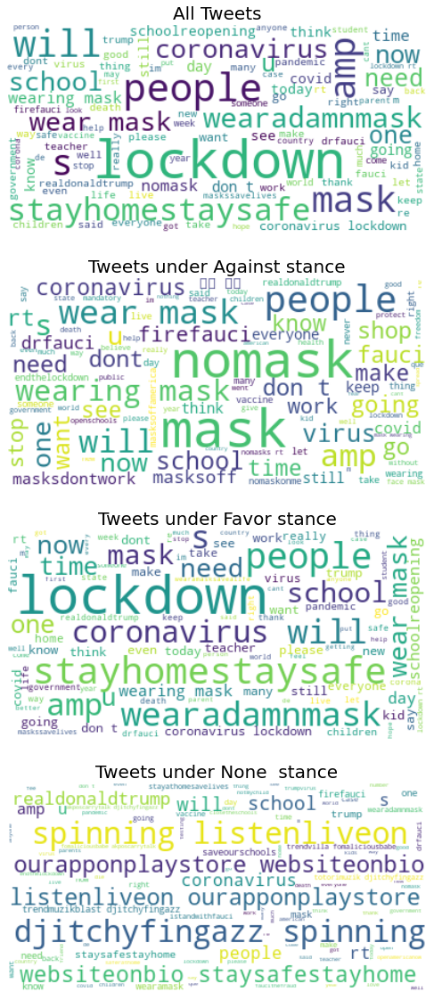

In [ ]:
# Start with one review:
df_A = df[df['Stance']=='AGAINST']
df_F = df[df['Stance']=='FAVOR']
df_N = df[df['Stance']=='NONE']
tweet_All = " ".join(review for review in df.tweet)
tweet_A = " ".join(review for review in df_A.tweet)
tweet_F = " ".join(review for review in df_F.tweet)
tweet_N = " ".join(review for review in df_N.tweet)
fig, ax = plt.subplots(4, 1, figsize  = (20,20))

# Create and generate a word cloud image:
wordcloud_ALL = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(tweet_All)
wordcloud_A = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(tweet_A)
wordcloud_F = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(tweet_F)
wordcloud_N = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(tweet_N)
# Display the generated image:
ax[0].imshow(wordcloud_ALL, interpolation='bilinear')
ax[0].set_title('All Tweets', fontsize=20)
ax[0].axis('off')
ax[1].imshow(wordcloud_A, interpolation='bilinear')
ax[1].set_title('Tweets under Against stance',fontsize=20)
ax[1].axis('off')
ax[2].imshow(wordcloud_F, interpolation='bilinear')
ax[2].set_title('Tweets under Favor stance',fontsize=20)
ax[2].axis('off')
ax[3].imshow(wordcloud_N, interpolation='bilinear')
ax[3].set_title('Tweets under None  stance',fontsize=20)
ax[3].axis('off')

In [ ]:
df['temp_list'] = df['tweet'].apply(lambda x:str(x).split())
FAVOR_sent = df[df['Stance']=='FAVOR']
AGAINST_sent = df[df['Stance']=='AGAINST']
NONE_sent = df[df['Stance']=='NONE']

In [ ]:
#MosT 20 common favor words
top = Counter([item for sublist in FAVOR_sent['temp_list'] for item in sublist])
temp_positive = pd.DataFrame(top.most_common(20))
temp_positive.columns = ['Common_words','count']
temp_positive.style.background_gradient(cmap='Greens')

,Common_words,count
0,lockdown,3777
1,stayhomestaysafe,1440
2,coronavirus,1419
3,mask,1374
4,people,1269
5,wearadamnmask,1236
6,will,1064
7,amp,834
8,wear,827
9,schools,782


In [ ]:
fig = px.treemap(temp_positive, path=['Common_words'], values='count',title='Tree of Most Common FAVOR Words')
fig.show()

In [ ]:
#MosT 20 common against words
top = Counter([item for sublist in AGAINST_sent['temp_list'] for item in sublist])
temp_positive = pd.DataFrame(top.most_common(20))
temp_positive.columns = ['Common_words','count']
temp_positive.style.background_gradient(cmap='Reds')

,Common_words,count
0,mask,668
1,nomasks,546
2,masks,480
3,wear,327
4,people,274
5,wearing,268
6,will,194
7,amp,190
8,one,178
9,rt,174


In [ ]:
fig = px.treemap(temp_positive, path=['Common_words'], values='count',title='Tree of Most Common AGAINST Words')
fig.show()

In [ ]:
#MosT 20 common None words
top = Counter([item for sublist in NONE_sent['temp_list'] for item in sublist])
temp_positive = pd.DataFrame(top.most_common(20))
temp_positive.columns = ['Common_words','count']
temp_positive.style.background_gradient(cmap='Blues')

,Common_words,count
0,staysafestayhome,266
1,djitchyfingazz,160
2,spinning,160
3,listenliveon,160
4,ourapponplaystore,160
5,websiteonbio,160
6,will,125
7,schools,121
8,rt,117
9,coronavirus,107


In [ ]:
fig = px.treemap(temp_positive, path=['Common_words'], values='count',title='Tree of Most Common NONE Words')
fig.show()

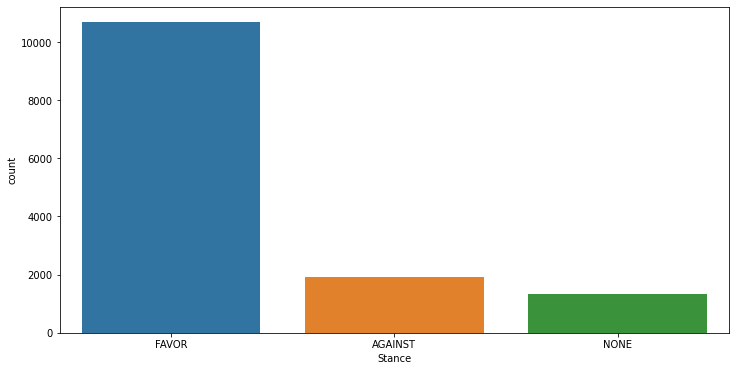

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(x='Stance',data=df)

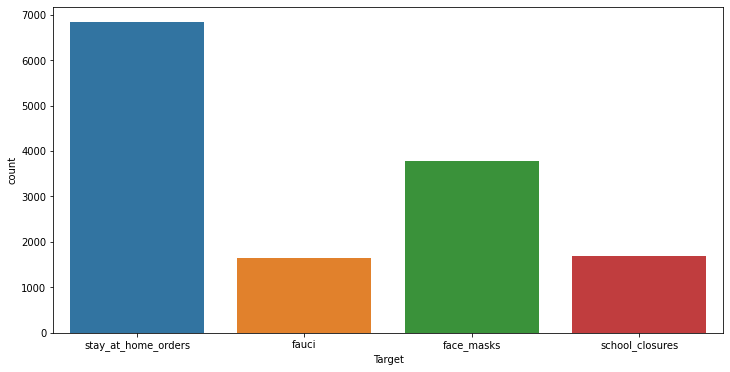

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(x='Target',data=df)

In [ ]:
lb= LabelEncoder()
lb.fit(df['Stance'])
classes= list(lb.classes_)
print(classes)
df['Stance']= lb.fit_transform(df['Stance'])

['AGAINST', 'FAVOR', 'NONE']


# Implementing BERT


In [ ]:
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

In [ ]:
#setting device to GPU
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
device

device(type='cuda', index=0)

In [ ]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True)

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/570 [00:00<?, ?B/s]

# Stance detection 


In [ ]:
class Covid19Tweet(Dataset):
    
    def __init__(self, tweet, Stance, tokenizer, max_len):
        self.tweet = tweet
        self.Stance = Stance
        self.tokenizer = tokenizer
        self.max_len = max_len
    def __len__(self):
        return len(self.tweet)
    def __getitem__(self, item):
        
        tweet = str(self.tweet[item])
        Stance = self.Stance[item]
        encoding = self.tokenizer.encode_plus(
        tweet,
        add_special_tokens=True,
        max_length=self.max_len,
        return_token_type_ids=False,
        pad_to_max_length=True,
        return_attention_mask=True,
        return_tensors='pt')
        return {
        'tweet': tweet,
         'input_ids': encoding['input_ids'].flatten(),
         'attention_mask': encoding['attention_mask'].flatten(),
         'Stance': torch.tensor(Stance, dtype=torch.long)
          }

In [ ]:
def create_data_loader(data, tokenizer, max_len, batch_size):
    
    ds = Covid19Tweet(tweet=data.tweet.to_numpy(),
    Stance=data.Stance.to_numpy(),
    tokenizer=tokenizer,
    max_len=max_len)
    return DataLoader(
    ds,
    batch_size=batch_size,
    num_workers=4)

In [ ]:
class StanceClassifier(nn.Module):
    
    def __init__(self, n_classes):
        
        super(StanceClassifier, self).__init__()
        self.bert = BertModel.from_pretrained('bert-base-uncased')
        self.drop = nn.Dropout(p=0.3)
        self.out = nn.Linear(self.bert.config.hidden_size, n_classes)
    def forward(self, input_ids, attention_mask):
        
        _, pooled_output = self.bert(
        input_ids=input_ids,
        attention_mask=attention_mask,
        return_dict=False
    )
        output = self.drop(pooled_output)
        return self.out(output)

In [ ]:
def train_epoch(model,data_loader,loss_fn,optimizer,device,scheduler, n_examples):  
    model = model.train()
    losses = []
    correct_predictions = 0
    for d in data_loader:
        
        input_ids = d["input_ids"].to(device)
        attention_mask = d["attention_mask"].to(device)
        targets = d["Stance"].to(device)
        outputs = model(input_ids=input_ids,attention_mask=attention_mask)
        _, preds = torch.max(outputs, dim=1)
        loss = loss_fn(outputs, targets)
        correct_predictions += torch.sum(preds == targets)
        losses.append(loss.item())
        loss.backward()
        nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()
        scheduler.step()
        optimizer.zero_grad()
    return correct_predictions.double() / n_examples, np.mean(losses)

In [ ]:
def eval_model(model, data_loader, loss_fn, device, n_examples):
    
    model = model.eval()
    losses = []
    correct_predictions = 0
    with torch.no_grad():
        for d in data_loader:
            input_ids = d["input_ids"].to(device)
            attention_mask = d["attention_mask"].to(device)
            targets = d["Stance"].to(device)
            outputs = model(input_ids=input_ids,attention_mask=attention_mask)
            _, preds = torch.max(outputs, dim=1)
            loss = loss_fn(outputs, targets)
            correct_predictions += torch.sum(preds == targets)
            losses.append(loss.item())
        return correct_predictions.double() / n_examples, np.mean(losses)

In [ ]:
def get_predictions(model, data_loader):
  model = model.eval()
  review_texts = []
  predictions = []
  prediction_probs = []
  real_values = []
  with torch.no_grad():
    for d in data_loader:
      texts = d["tweet"]
      input_ids = d["input_ids"].to(device)
      attention_mask = d["attention_mask"].to(device)
      targets = d["Stance"].to(device)
      outputs = model(
        input_ids=input_ids,
        attention_mask=attention_mask
      )
      _, preds = torch.max(outputs, dim=1)
      review_texts.extend(texts)
      predictions.extend(preds)
      prediction_probs.extend(outputs)
      real_values.extend(targets)
  predictions = torch.stack(predictions).cpu()
  prediction_probs = torch.stack(prediction_probs).cpu()
  real_values = torch.stack(real_values).cpu()
  return review_texts, predictions, prediction_probs, real_values

In [ ]:
data= df[df['Target'] == 'stay_at_home_orders']
data2=df[df['Target'] == 'school_closures']
data3=df[df['Target'] == 'fauci']
data4=df[df['Target'] == 'face_masks']

In [ ]:
data['temp_list'] = data['tweet'].apply(lambda x:str(x).split())

In [ ]:
#MosT 20 common favor words
top = Counter([item for sublist in data['temp_list'] for item in sublist])
temp_positive = pd.DataFrame(top.most_common(20))
temp_positive.columns = ['Common_words','count']
temp_positive.style.background_gradient(cmap='Greens')

,Common_words,count
0,lockdown,3764
1,stayhomestaysafe,1438
2,coronavirus,1068
3,people,636
4,will,631
5,cases,498
6,amp,439
7,rt,421
8,now,364
9,one,331


In [ ]:
data2['temp_list'] = data2['tweet'].apply(lambda x:str(x).split())

In [ ]:
top = Counter([item for sublist in data2['temp_list'] for item in sublist])
temp_positive = pd.DataFrame(top.most_common(20))
temp_positive.columns = ['Common_words','count']
temp_positive.style.background_gradient(cmap='Greens')

,Common_words,count
0,schools,924
1,schoolreopening,495
2,school,474
3,will,308
4,kids,296
5,teachers,253
6,children,223
7,amp,185
8,open,144
9,back,138


In [ ]:
data3['temp_list'] = data3['tweet'].apply(lambda x:str(x).split())

In [ ]:
top = Counter([item for sublist in data3['temp_list'] for item in sublist])
temp_positive = pd.DataFrame(top.most_common(20))
temp_positive.columns = ['Common_words','count']
temp_positive.style.background_gradient(cmap='Greens')

,Common_words,count
0,fauci,435
1,drfauci,365
2,firefauci,314
3,coronavirus,272
4,realdonaldtrump,252
5,amp,182
6,people,159
7,rt,154
8,trump,151
9,dr,133


In [ ]:
data4['temp_list'] = data4['tweet'].apply(lambda x:str(x).split())

In [ ]:
top = Counter([item for sublist in data4['temp_list'] for item in sublist])
temp_positive = pd.DataFrame(top.most_common(20))
temp_positive.columns = ['Common_words','count']
temp_positive.style.background_gradient(cmap='Greens')

,Common_words,count
0,mask,1850
1,wearadamnmask,1262
2,masks,1051
3,wear,1022
4,wearing,808
5,people,731
6,nomasks,577
7,one,333
8,will,324
9,amp,294


#target="stay at home orders"

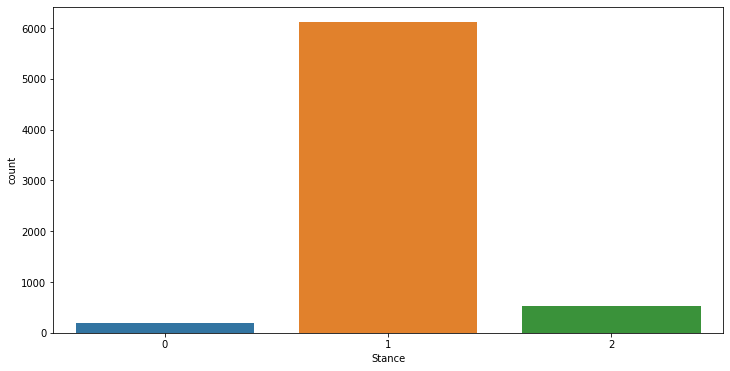

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(x='Stance',data=data)

In [ ]:
class_0 = data[data['Stance'] == 0]#against
class_1 = data[data['Stance'] == 1]#favor
class_2 = data[data['Stance'] == 2]#none

print('class 0:', class_0.shape)
print('class 1:', class_1.shape)
print('class 2:', class_2.shape)

class 0: (193, 7)
class 1: (6114, 7)
class 2: (525, 7)


In [ ]:
token_lens = []
for txt in data.tweet:
    tokens = tokenizer.encode(txt, max_length=512)
    token_lens.append(len(tokens))


Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.


Text(0.5, 0, 'Token count')

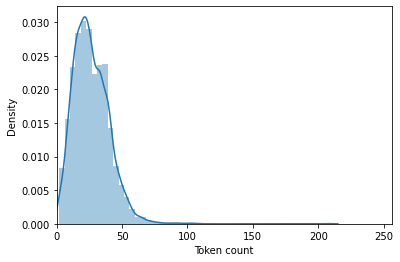

In [ ]:
sns.distplot(token_lens)
plt.xlim([0, 256]);
plt.xlabel('Token count')

In [ ]:
MAX_LEN=220

In [ ]:
train, val = train_test_split(
  data,
  test_size=0.3,
  random_state=RANDOM_SEED
)
test, val = train_test_split(
  val,
  test_size=0.8,
  random_state=RANDOM_SEED
)

In [ ]:
train.shape,val.shape,test.shape

((4782, 7), (1640, 7), (410, 7))

In [ ]:
BATCH_SIZE = 32
train_data_loader = create_data_loader(train, tokenizer, MAX_LEN, BATCH_SIZE)
val_data_loader = create_data_loader(val, tokenizer, MAX_LEN, BATCH_SIZE)
test_data_loader = create_data_loader(test, tokenizer, MAX_LEN, BATCH_SIZE)

In [ ]:
df = next(iter(train_data_loader))
df.keys()

dict_keys(['tweet', 'input_ids', 'attention_mask', 'Stance'])

In [ ]:
print(df['input_ids'].shape)
print(df['attention_mask'].shape)
print(df['Stance'].shape)

torch.Size([32, 220])
torch.Size([32, 220])
torch.Size([32])


In [ ]:
bert_model = BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True)

In [ ]:
n_classes= 3

In [ ]:
model = StanceClassifier(n_classes)
model = model.to(device)

Downloading:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.predictions.decoder.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
input_ids = df['input_ids'].to(device)
attention_mask = df['attention_mask'].to(device)

In [ ]:
print(input_ids.shape) # batch size x seq length
print(attention_mask.shape)

torch.Size([32, 220])
torch.Size([32, 220])


In [ ]:
input_ids=torch.tensor(input_ids)

In [ ]:
F.softmax(model(input_ids, attention_mask),dim=1)

tensor([[0.2697, 0.3545, 0.3759],
        [0.2179, 0.5951, 0.1871],
        [0.2063, 0.5645, 0.2292],
        [0.2860, 0.4929, 0.2211],
        [0.3044, 0.4625, 0.2331],
        [0.2199, 0.4218, 0.3583],
        [0.2430, 0.4431, 0.3139],
        [0.3169, 0.5063, 0.1768],
        [0.2049, 0.5009, 0.2942],
        [0.3345, 0.4663, 0.1993],
        [0.2959, 0.5103, 0.1937],
        [0.3212, 0.2622, 0.4167],
        [0.2053, 0.5737, 0.2210],
        [0.2951, 0.4724, 0.2325],
        [0.3928, 0.4207, 0.1866],
        [0.2195, 0.5265, 0.2540],
        [0.2722, 0.3342, 0.3936],
        [0.3226, 0.4836, 0.1938],
        [0.2906, 0.5071, 0.2023],
        [0.2909, 0.5035, 0.2056],
        [0.2633, 0.5164, 0.2203],
        [0.3009, 0.4249, 0.2742],
        [0.1924, 0.4342, 0.3734],
        [0.3583, 0.4152, 0.2265],
        [0.2854, 0.5161, 0.1986],
        [0.3226, 0.4517, 0.2257],
        [0.2155, 0.3974, 0.3871],
        [0.2757, 0.4703, 0.2539],
        [0.2982, 0.5087, 0.1931],
        [0.282

In [ ]:
model.parameters

<bound method Module.parameters of StanceClassifier(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0): BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768

In [ ]:
#change the learning rate, nb of epochs 
EPOCHS = 10
optimizer = AdamW(model.parameters(), lr=2e-5, correct_bias=False)
total_steps = len(train_data_loader) * EPOCHS
scheduler = get_linear_schedule_with_warmup(
  optimizer,
  num_warmup_steps=0,
  num_training_steps=total_steps
)
weights=torch.FloatTensor([31.678,1,11.6457]).cuda()
loss_fn = nn.CrossEntropyLoss(weights).to(device)

In [ ]:
%%time
history = defaultdict(list)
best_accuracy = 0
for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}/{EPOCHS}')
    print('-' * 10)
    train_acc, train_loss = train_epoch(model,train_data_loader,loss_fn,optimizer,device,scheduler,len(train))
    print(f'Train loss {train_loss} accuracy {train_acc}')

    val_acc, val_loss = eval_model(model,val_data_loader,loss_fn,device,len(val))
    print(f'Val   loss {val_loss} accuracy {val_acc}')
    print()
    history['train_acc'].append(train_acc)
    history['train_loss'].append(train_loss)
    history['val_acc'].append(val_acc)
    history['val_loss'].append(val_loss)
    if val_acc > best_accuracy:
      torch.save(model.state_dict(), 'best_model_state.bin')
      best_accuracy = val_acc

Epoch 1/10
----------
Train loss 0.6750964360932509 accuracy 0.849853617733166
Val   loss 0.5753564694179938 accuracy 0.9457317073170731

Epoch 2/10
----------
Train loss 0.4700461036339402 accuracy 0.9374738603094939
Val   loss 0.6093731410443209 accuracy 0.9439024390243902

Epoch 3/10
----------
Train loss 0.3837699926365167 accuracy 0.9581764951902969
Val   loss 0.7135856684449559 accuracy 0.9640243902439024

Epoch 4/10
----------
Train loss 0.23604042196723943 accuracy 0.9784608950230029
Val   loss 0.8591821031385245 accuracy 0.9664634146341463

Epoch 5/10
----------
Train loss 0.12300782817571114 accuracy 0.9903805938937683
Val   loss 0.8387400447659624 accuracy 0.9725609756097561

Epoch 6/10
----------
Train loss 0.0736719580871674 accuracy 0.9943538268506901
Val   loss 0.7266055632543822 accuracy 0.9725609756097561

Epoch 7/10
----------
Train loss 0.03881287541977751 accuracy 0.9966541196152238
Val   loss 0.7929558906180318 accuracy 0.974390243902439

Epoch 8/10
----------
Trai

In [ ]:
print(best_accuracy)

tensor(0.9780, device='cuda:0', dtype=torch.float64)


In [ ]:
for i in range(0,10):
    print(history['val_acc'][i].item())

0.9457317073170731
0.9439024390243902
0.9640243902439024
0.9664634146341463
0.9725609756097561
0.9725609756097561
0.974390243902439
0.975609756097561
0.9774390243902439
0.9780487804878049


In [ ]:
history['train_acc'][0].cpu().item()

0.849853617733166

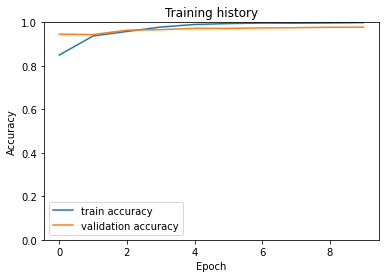

In [ ]:
import matplotlib.pyplot as plt
a = []
b=[]
for i in range(0,10):
    # change a = a.append(i) to    
    a.append(history['train_acc'][i].cpu().item())
    b.append(history['val_acc'][i].cpu().item())
plt.plot(a, label='train accuracy')
plt.plot(b, label='validation accuracy')
plt.title('Training history')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.ylim([0, 1]);

In [ ]:
history['train_loss']

[0.6750964360932509,
 0.4700461036339402,
 0.3837699926365167,
 0.23604042196723943,
 0.12300782817571114,
 0.0736719580871674,
 0.03881287541977751,
 0.05221609392591442,
 0.04327450909341375,
 0.03129118068589984]

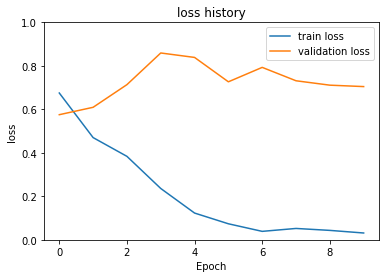

In [ ]:
import matplotlib.pyplot as plt
a = []
b=[]
for i in range(0,10):
    # change a = a.append(i) to    
    a.append(history['train_loss'][i])
    b.append(history['val_loss'][i])
plt.plot(a, label='train loss')
plt.plot(b, label='validation loss')
plt.title('loss history')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.legend()
plt.ylim([0, 1]);

In [ ]:
test_acc, _ = eval_model(
  model,
  test_data_loader,
  loss_fn,
  device,
  len(test)
)
test_acc.item()

0.9780487804878049

In [ ]:
y_review_texts, y_pred, y_pred_probs, y_test = get_predictions(
  model,
  test_data_loader
)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred, target_names=classes))

              precision    recall  f1-score   support

     AGAINST       0.70      0.70      0.70        10
       FAVOR       0.99      0.99      0.99       367
        NONE       0.94      0.91      0.92        33

    accuracy                           0.98       410
   macro avg       0.88      0.87      0.87       410
weighted avg       0.98      0.98      0.98       410



In [ ]:
tweets=df_rostom['tweet']

In [ ]:
liste=[]
liste2=[]
for i in tweets:
      encoded_review = tokenizer.encode_plus(i,max_length=MAX_LEN,add_special_tokens=True,
                                           return_token_type_ids=False,pad_to_max_length=True,return_attention_mask=True,
                                           return_tensors='pt')
      input_ids = encoded_review['input_ids'].to(device)
      attention_mask = encoded_review['attention_mask'].to(device)
      output = model(input_ids, attention_mask)
      _, prediction = torch.max(output, dim=1)
      liste.append(i)
      liste2.append(classes[prediction])

In [ ]:
d = {'tweet':liste,'stance':liste2,'emotion':df_rostom['emotion']}
df_rs=pd.DataFrame(d)


In [ ]:
df_rs['emotion'] = df_rs['emotion'].replace(np.nan, 'N')

In [ ]:
df_rs

,tweet,stance,emotion
0,Covid-19 restrictions extended to travellers f...,FAVOR,N
1,"Best guess, worst case scenario US #COVID-19: ...",FAVOR,F
2,@Vampiric_Kai I have enough with Corona infect...,FAVOR,F
3,@Firatondr german doner with corona :D,FAVOR,H
4,The Diamond Princess cruise ship quarantine li...,FAVOR,F
...,...,...,...
99995,Look after yourselves and everyone else. Coron...,FAVOR,A
99996,The number of cases of COVID-19 has surpassed ...,AGAINST,H
99997,LeadingAge Colorado will continue to support a...,FAVOR,H
99998,@jonlovett putting Pence in charge of corona v...,AGAINST,F


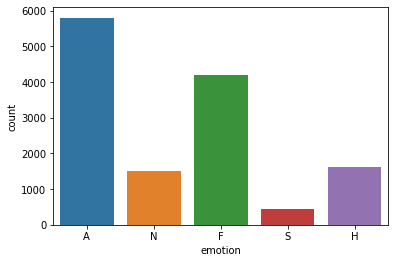

In [ ]:
# Count the occurrences of each label in the "pred" column
label_counts = df_rs[df_rs.stance=='AGAINST']['emotion'].value_counts()

# Get the counts for the "left", "right", and "Other" labels
F_count = label_counts['F'] if 'Left' in label_counts else 0
H_count = label_counts['H'] if 'Right' in label_counts else 0
S_count = label_counts['S'] if 'Other' in label_counts else 0
A_count = label_counts['A'] if 'Other' in label_counts else 0
N_count = label_counts['N'] if 'Other' in label_counts else 0

# Create a bar chart
x = np.arange(3)
y = [F_count, H_count, S_count,A_count,N_count]
colors = ['orange', 'pink', 'blue','red','green']
labels = ['F', 'H', 'S','A','N']
plt.bar(x, y, color=colors)

# Add labels to the x-axis
plt.xticks(x, labels)

# Set the title of the graph
plt.title('Against Label Counts')

# Display the graph
plt.show()

In [ ]:
filtered_df = df_rs.query('stance == "AGAINST" and emotion == "A"')
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
filtered_df.head()

,tweet,stance,emotion
9,All these people coming into work asking if we...,AGAINST,A
18,sick of people criticizing others for going in...,AGAINST,A
56,@mitchellvii You don't know what the hell you'...,AGAINST,A
57,Would they not just put a massive dome around ...,AGAINST,A
63,@RawStory This guy is an establishment goon to...,AGAINST,A


In [ ]:
filtered_df = df_rs.query('stance == "AGAINST" and emotion == "F"')
filtered_df

,tweet,stance,emotion
48,"March 16, 2:00 pm EST, 2020 Total global death...",AGAINST,F
101,"@AnandWrites Not true, blatant lie.\n\nIn a vi...",AGAINST,F
136,@ntrider825 I’m not sure he realizes he’s in C...,AGAINST,F
198,Looking at the Countries that are affected by ...,AGAINST,F
213,"@ja54kki Yeah, it's the mass hysteria that's m...",AGAINST,F
...,...,...,...
99910,When your wife is scared of the corona virus e...,AGAINST,F
99923,COVID-19 strikes to take down universities htt...,AGAINST,F
99926,"I mean, Coronavirus is scary and everything. B...",AGAINST,F
99929,Covid-19 is not biological warfare engineered ...,AGAINST,F


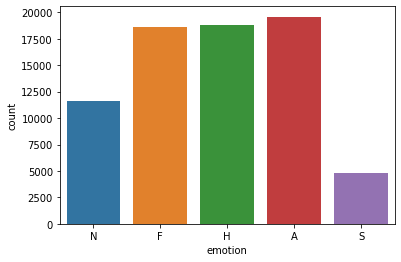

In [ ]:
# Count the occurrences of each label in the "pred" column
label_counts = df_rs[df_rs.stance=='FAVOR']['emotion'].value_counts()

# Get the counts for the "left", "right", and "Other" labels
F_count = label_counts['F'] if 'Left' in label_counts else 0
H_count = label_counts['H'] if 'Right' in label_counts else 0
S_count = label_counts['S'] if 'Other' in label_counts else 0
A_count = label_counts['A'] if 'Other' in label_counts else 0
N_count = label_counts['N'] if 'Other' in label_counts else 0

# Create a bar chart
x = np.arange(3)
y = [F_count, H_count, S_count,A_count,N_count]
colors = ['orange', 'pink', 'blue','red','green']
labels = ['F', 'H', 'S','A','N']
plt.bar(x, y, color=colors)

# Add labels to the x-axis
plt.xticks(x, labels)

# Set the title of the graph
plt.title('Favor Label Counts')

# Display the graph
plt.show()

In [ ]:
filtered_df = df_rs.query('stance == "FAVOR" and emotion == "A"')
filtered_df

,tweet,stance,emotion
5,@RamzZy_ Our Gov't officials are blindly focus...,FAVOR,A
15,The MLB canceled spring training games and del...,FAVOR,A
17,So where was this news in Trumps puff piece pr...,FAVOR,A
26,Poor old Corona. A few years back there was th...,FAVOR,A
29,One of the many reasons I don't want to get Co...,FAVOR,A
30,that whole corona virus meeting was just my ol...,FAVOR,A
35,@OC_Transpo is changing it’s operations in lig...,FAVOR,A
45,****COVID-19 but y’all get the joke 😭,FAVOR,A
51,imagine having to tell people you got corona a...,FAVOR,A
52,@SillyTiddy All remaining games should either ...,FAVOR,A


In [ ]:
filtered_df = df_rs.query('stance == "FAVOR" and emotion == "H"')
filtered_df

,tweet,stance,emotion
3,@Firatondr german doner with corona :D,FAVOR,H
6,Online lessons only from now until further not...,FAVOR,H
11,@KSchafheutle @timolarch Now #UKChancellor her...,FAVOR,H
14,First suspected case of Wuhan coronavirus in B...,FAVOR,H
31,Motivation in the time of corona https://t.co/...,FAVOR,H
37,Social Distancing\n.\n#vt #vermont #sunset #na...,FAVOR,H
39,@VaraAshton is actually the smartest one of us...,FAVOR,H
40,Mikey Mouse is mine :)\n#Covid_19 #Corona #نصر...,FAVOR,H
43,@Messybaldyy Saved the pictures so fast. This ...,FAVOR,H
44,"@adelso_corona a man of many talents, this ske...",FAVOR,H


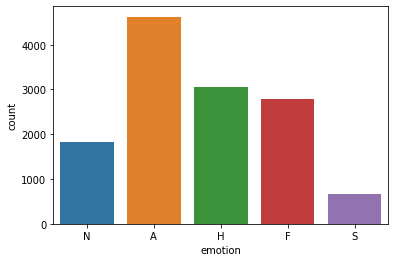

In [ ]:
# Count the occurrences of each label in the "pred" column
label_counts = df_rs[df_rs.stance=='NONE']['emotion'].value_counts()

# Get the counts for the "left", "right", and "Other" labels
F_count = label_counts['F'] if 'Left' in label_counts else 0
H_count = label_counts['H'] if 'Right' in label_counts else 0
S_count = label_counts['S'] if 'Other' in label_counts else 0
A_count = label_counts['A'] if 'Other' in label_counts else 0
N_count = label_counts['N'] if 'Other' in label_counts else 0

# Create a bar chart
x = np.arange(3)
y = [F_count, H_count, S_count,A_count,N_count]
colors = ['orange', 'pink', 'blue','red','green']
labels = ['F', 'H', 'S','A','N']
plt.bar(x, y, color=colors)

# Add labels to the x-axis
plt.xticks(x, labels)

# Set the title of the graph
plt.title('None Label Counts')

# Display the graph
plt.show()

In [ ]:
filtered_df = df_rs.query('stance == "NONE" and emotion == "A"')
filtered_df

,tweet,stance,emotion
19,Pretend I made a Corona Virus joke hand crafte...,NONE,A
36,@AdamParkhomenko @CheriJacobus I couldn’t even...,NONE,A
84,"@GOPLeader ummmmm......not quite everything, l...",NONE,A
111,@SKY3691111 So Corona virus is only a cover to...,NONE,A
132,bouta cop corona .. let’s see what’s the hype ...,NONE,A
158,@MollyJongFast CNN reported a woman in the the...,NONE,A
161,"Contrary to Trump’s claim, Google is not build...",NONE,A
173,I actually need to sit down tomorrow and look ...,NONE,A
214,@chelseahandler seriously: can we put the Pres...,NONE,A
215,@b_enleitch01 @BBCSport That's what will happe...,NONE,A


In [ ]:
tweets=df_abhishek['tweet']

In [ ]:
liste=[]
liste2=[]
for i in tweets:
      encoded_review = tokenizer.encode_plus(i,max_length=MAX_LEN,add_special_tokens=True,
                                           return_token_type_ids=False,pad_to_max_length=True,return_attention_mask=True,
                                           return_tensors='pt')
      input_ids = encoded_review['input_ids'].to(device)
      attention_mask = encoded_review['attention_mask'].to(device)
      output = model(input_ids, attention_mask)
      _, prediction = torch.max(output, dim=1)
      liste.append(i)
      liste2.append(classes[prediction])

In [ ]:
d = {'tweet':liste,'stance':liste2,'sentiment':df_abhishek.label}

In [ ]:
df_ab=pd.DataFrame(d)

In [ ]:
df_ab

,tweet,stance,sentiment
0,Coronavirus | Human Coronavirus Types | CDC ht...,FAVOR,neu
1,"@shehryar_taseer That‚Äôs üíØ true , \nCorona...",FAVOR,neu
2,"TLDR: Not SARS, possibly new coronavirus. Diff...",FAVOR,neg
3,Disease outbreak news from the WHO: Middle Eas...,FAVOR,neu
4,China - Media: WSJ says sources tell them myst...,FAVOR,neu
...,...,...,...
89995,@C_Racing48 The flu has a 2% death rate.. the ...,FAVOR,neu
89996,@realDonaldTrump We already know that but you‚...,FAVOR,neg
89997,First coronavirus case reported in St. Joseph ...,FAVOR,neu
89998,"If you ate ants when you were a child, you‚Äôr...",AGAINST,neu


In [ ]:
df_ab['stance'].nunique()

3

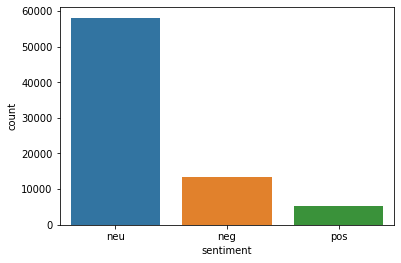

In [ ]:
# Count the occurrences of each label in the "pred" column
label_counts = df_ab[df_ab.stance=='FAVOR']['sentiment'].value_counts()

# Get the counts for the "left", "right", and "Other" labels
neg_count = label_counts['neg'] if 'neg' in label_counts else 0
pos_count = label_counts['pos'] if 'pos' in label_counts else 0
neu_count = label_counts['neu'] if 'neu' in label_counts else 0


# Create a bar chart
x = np.arange(3)
y = [neg_count, pos_count, neu_count]
colors = ['red', 'green', 'orange']
labels = ['neg', 'pos', 'neu']
plt.bar(x, y, color=colors)

# Add labels to the x-axis
plt.xticks(x, labels)

# Set the title of the graph
plt.title('favor Label Counts')

# Display the graph
plt.show()

In [ ]:
filtered_df = df_ab.query('stance == "FAVOR" and sentiment == "neu"')
filtered_df

,tweet,stance,sentiment
0,Coronavirus | Human Coronavirus Types | CDC ht...,FAVOR,neu
1,"@shehryar_taseer That‚Äôs üíØ true , \nCorona...",FAVOR,neu
3,Disease outbreak news from the WHO: Middle Eas...,FAVOR,neu
4,China - Media: WSJ says sources tell them myst...,FAVOR,neu
5,The mystery new virus causing #China pneumonia...,FAVOR,neu
6,Virologists weigh in on novel coronavirus in C...,FAVOR,neu
7,"""Chinese authorities have made a preliminary d...",FAVOR,neu
9,Chinese report says mysterious illnesses may b...,FAVOR,neu
10,China identifies new strain of coronavirus as ...,FAVOR,neu
12,Mystery illness in China traced to new SARS-fa...,FAVOR,neu


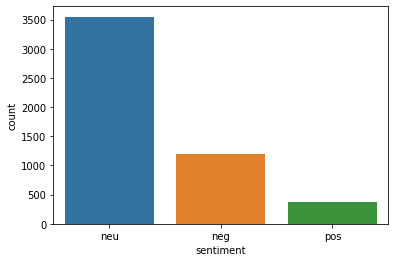

In [ ]:
# Count the occurrences of each label in the "pred" column
label_counts = df_ab[df_ab.stance=='AGAINST']['sentiment'].value_counts()

# Get the counts for the "left", "right", and "Other" labels
neg_count = label_counts['neg'] if 'neg' in label_counts else 0
pos_count = label_counts['pos'] if 'pos' in label_counts else 0
neu_count = label_counts['neu'] if 'neu' in label_counts else 0


# Create a bar chart
x = np.arange(3)
y = [neg_count, pos_count, neu_count]
colors = ['red', 'green', 'orange']
labels = ['neg', 'pos', 'neu']
plt.bar(x, y, color=colors)

# Add labels to the x-axis
plt.xticks(x, labels)

# Set the title of the graph
plt.title('Against Label Counts')

# Display the graph
plt.show()

In [ ]:
filtered_df = df_ab.query('stance == "AGAINST" and sentiment == "neu"')
filtered_df

,tweet,stance,sentiment
60,@BogochIsaac Any idea what it costs to do the ...,AGAINST,neu
63,This Coronavirus seems pretty bad; officials a...,AGAINST,neu
144,Boston doctor warns about spread of coronaviru...,AGAINST,neu
189,if corona virus can spread from cats to humans...,AGAINST,neu
209,bro the coronavirus made its way to the US,AGAINST,neu
239,@seanhannity My wife said something about a Co...,AGAINST,neu
251,shoutout to all the racist grandparents who to...,AGAINST,neu
264,@charliebilello The antidote to the coronaviru...,AGAINST,neu
281,U.S needs to quarantine all people traveling f...,AGAINST,neu
284,@Reuters Wont like this because I don't like i...,AGAINST,neu


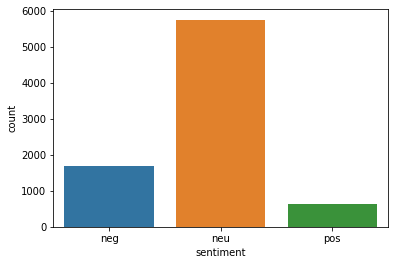

In [ ]:
# Count the occurrences of each label in the "sentiment" column
label_counts = df_ab[df_ab.stance=='NONE']['sentiment'].value_counts()

# Get the counts for the "left", "right", and "Other" labels
neg_count = label_counts['neg'] if 'neg' in label_counts else 0
pos_count = label_counts['pos'] if 'pos' in label_counts else 0
neu_count = label_counts['neu'] if 'neu' in label_counts else 0


# Create a bar chart
x = np.arange(3)
y = [neg_count, pos_count, neu_count]
colors = ['red', 'green', 'orange']
labels = ['neg', 'pos', 'neu']
plt.bar(x, y, color=colors)

# Add labels to the x-axis
plt.xticks(x, labels)

# Set the title of the graph
plt.title('None Label Counts')

# Display the graph
plt.show()


#target="school_closures"

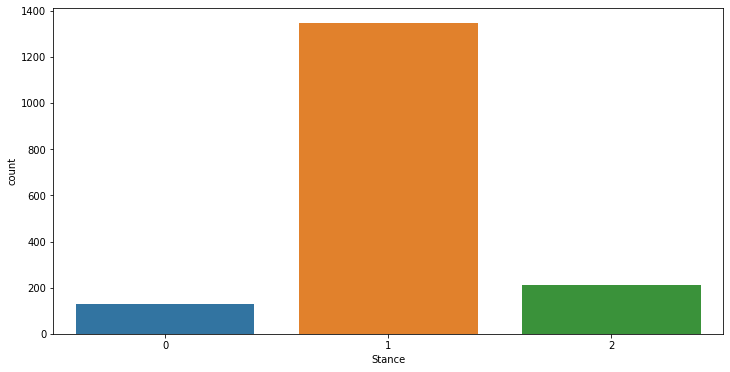

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(x='Stance',data=data2)

In [ ]:
class_0 = data2[data2['Stance'] == 0]#against
class_1 = data2[data2['Stance'] == 1]#favor
class_2 = data2[data2['Stance'] == 2]#none

print('class 0:', class_0.shape)
print('class 1:', class_1.shape)
print('class 2:', class_2.shape)

class 0: (128, 6)
class 1: (1347, 6)
class 2: (211, 6)


In [ ]:
token_lens = []
for txt in data2.tweet:
    tokens = tokenizer.encode(txt, max_length=512)
    token_lens.append(len(tokens))


Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.


Text(0.5, 0, 'Token count')

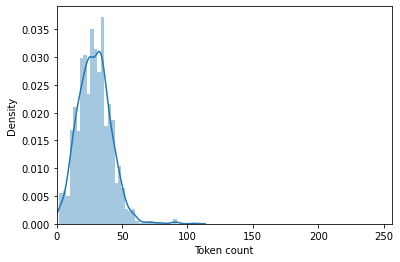

In [ ]:
sns.distplot(token_lens)
plt.xlim([0, 256]);
plt.xlabel('Token count')

In [ ]:
MAX_LEN=120

In [ ]:
from sklearn.model_selection import train_test_split
train, val = train_test_split(
  data2,
  test_size=0.3,
  random_state=RANDOM_SEED
)
test, val = train_test_split(
  val,
  test_size=0.8,
  random_state=RANDOM_SEED
)

In [ ]:
train.shape,val.shape,test.shape

((1180, 6), (405, 6), (101, 6))

In [ ]:
BATCH_SIZE = 32
train_data_loader = create_data_loader(train, tokenizer, MAX_LEN, BATCH_SIZE)
val_data_loader = create_data_loader(val, tokenizer, MAX_LEN, BATCH_SIZE)
test_data_loader = create_data_loader(test, tokenizer, MAX_LEN, BATCH_SIZE)

In [ ]:
df = next(iter(train_data_loader))
df.keys()

dict_keys(['tweet', 'input_ids', 'attention_mask', 'Stance'])

In [ ]:
model = StanceClassifier(3)
model = model.to(device)

Downloading:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
input_ids = df['input_ids'].to(device)
attention_mask = df['attention_mask'].to(device)

In [ ]:
input_ids=torch.tensor(input_ids)

In [ ]:
F.softmax(model(input_ids, attention_mask),dim=1)

tensor([[0.2575, 0.3580, 0.3845],
        [0.2590, 0.5325, 0.2085],
        [0.2117, 0.5582, 0.2302],
        [0.2837, 0.4961, 0.2203],
        [0.3019, 0.4538, 0.2443],
        [0.2609, 0.4216, 0.3175],
        [0.2276, 0.4345, 0.3379],
        [0.3131, 0.5192, 0.1677],
        [0.2023, 0.5463, 0.2515],
        [0.3355, 0.5054, 0.1591],
        [0.2658, 0.5603, 0.1738],
        [0.3214, 0.3438, 0.3349],
        [0.2241, 0.5843, 0.1916],
        [0.3208, 0.4635, 0.2157],
        [0.3601, 0.4354, 0.2045],
        [0.2523, 0.5052, 0.2425],
        [0.3112, 0.3668, 0.3220],
        [0.2912, 0.5180, 0.1908],
        [0.2617, 0.5711, 0.1671],
        [0.3130, 0.4612, 0.2258],
        [0.2630, 0.5205, 0.2165],
        [0.2810, 0.4259, 0.2932],
        [0.2231, 0.4900, 0.2869],
        [0.3200, 0.4461, 0.2339],
        [0.2137, 0.5186, 0.2677],
        [0.3940, 0.3814, 0.2246],
        [0.2349, 0.4040, 0.3611],
        [0.3125, 0.4150, 0.2725],
        [0.2931, 0.4678, 0.2391],
        [0.258

In [ ]:
model.parameters

<bound method Module.parameters of StanceClassifier(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0): BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768

In [ ]:
#change the learning rate, nb of epochs 
EPOCHS = 10
optimizer = AdamW(model.parameters(), lr=2e-5, correct_bias=False)
total_steps = len(train_data_loader) * EPOCHS
scheduler = get_linear_schedule_with_warmup(
  optimizer,
  num_warmup_steps=0,
  num_training_steps=total_steps
)
weights=torch.FloatTensor([10.5234375,1,6.38]).cuda()
loss_fn = nn.CrossEntropyLoss(weights).to(device)

In [ ]:
%%time
history = defaultdict(list)
best_accuracy = 0
for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}/{EPOCHS}')
    print('-' * 10)
    train_acc, train_loss = train_epoch(model,train_data_loader,loss_fn,optimizer,device,scheduler,len(train))
    print(f'Train loss {train_loss} accuracy {train_acc}')

    val_acc, val_loss = eval_model(model,val_data_loader,loss_fn,device,len(val))
    print(f'Val   loss {val_loss} accuracy {val_acc}')
    print()
    history['train_acc'].append(train_acc)
    history['train_loss'].append(train_loss)
    history['val_acc'].append(val_acc)
    history['val_loss'].append(val_loss)
    if val_acc > best_accuracy:
      torch.save(model.state_dict(), 'best_model_state.bin')
      best_accuracy = val_acc

Epoch 1/10
----------
Train loss 1.1220700708595481 accuracy 0.45932203389830506
Val   loss 1.1439786232434785 accuracy 0.05925925925925926

Epoch 2/10
----------
Train loss 1.0638664364814758 accuracy 0.5313559322033898
Val   loss 1.0451471301225514 accuracy 0.5925925925925926

Epoch 3/10
----------
Train loss 0.9022926688194275 accuracy 0.6796610169491525
Val   loss 0.8912329444518456 accuracy 0.7382716049382716

Epoch 4/10
----------
Train loss 0.6755676462843612 accuracy 0.8042372881355931
Val   loss 0.77048682478758 accuracy 0.8049382716049382

Epoch 5/10
----------
Train loss 0.4967757523865313 accuracy 0.8694915254237288
Val   loss 0.891011662208117 accuracy 0.8246913580246913

Epoch 6/10
----------
Train loss 0.29040002963832906 accuracy 0.9271186440677965
Val   loss 0.9535113148964368 accuracy 0.837037037037037

Epoch 7/10
----------
Train loss 0.22107940574956908 accuracy 0.9525423728813559
Val   loss 0.957981153176381 accuracy 0.8395061728395061

Epoch 8/10
----------
Train 

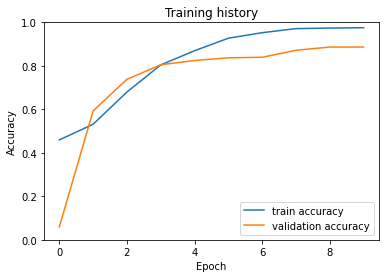

In [ ]:
a = []
b=[]
for i in range(0,10):
    # change a = a.append(i) to    
    a.append(history['train_acc'][i].cpu().item())
    b.append(history['val_acc'][i].cpu().item())
plt.plot(a, label='train accuracy')
plt.plot(b, label='validation accuracy')
plt.title('Training history')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.ylim([0, 1]);

In [ ]:
test_acc, _ = eval_model(
  model,
  test_data_loader,
  loss_fn,
  device,
  len(test)
)
test_acc.item()

0.900990099009901

In [ ]:
y_review_texts, y_pred, y_pred_probs, y_test = get_predictions(
  model,
  test_data_loader
)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred, target_names=classes))

              precision    recall  f1-score   support

     AGAINST       0.67      0.33      0.44         6
       FAVOR       0.94      0.96      0.95        80
        NONE       0.75      0.80      0.77        15

    accuracy                           0.90       101
   macro avg       0.79      0.70      0.72       101
weighted avg       0.89      0.90      0.89       101



In [ ]:
tweets=df_rostom['tweet']

In [ ]:
liste=[]
liste2=[]
for i in tweets:
      encoded_review = tokenizer.encode_plus(i,max_length=MAX_LEN,add_special_tokens=True,
                                           return_token_type_ids=False,pad_to_max_length=True,return_attention_mask=True,
                                           return_tensors='pt')
      input_ids = encoded_review['input_ids'].to(device)
      attention_mask = encoded_review['attention_mask'].to(device)
      output = model(input_ids, attention_mask)
      _, prediction = torch.max(output, dim=1)
      liste.append(i)
      liste2.append(classes[prediction])

In [ ]:
d = {'tweet':liste,'stance':liste2,'emotion':df_rostom.emotion}
df_rs=pd.DataFrame(d)
df_rs['emotion'] = df_rs['emotion'].replace(np.nan, 'N')

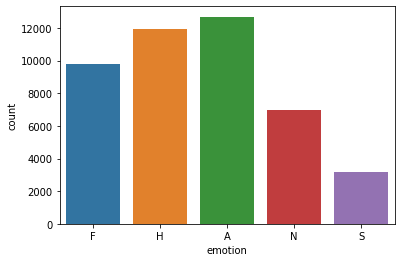

In [ ]:
sns.countplot(df_rs[df_rs.stance=='FAVOR']['emotion'])

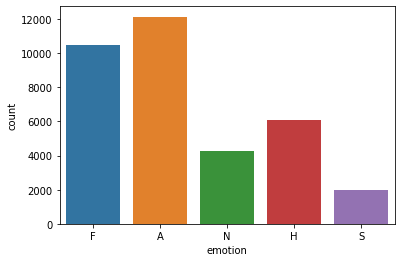

In [ ]:
sns.countplot(df_rs[df_rs.stance=='AGAINST']['emotion'])

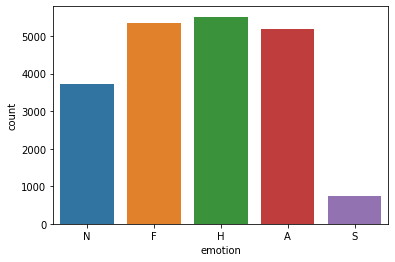

In [ ]:
sns.countplot(df_rs[df_rs.stance=='NONE']['emotion'])

In [ ]:
tweets=df_abhishek['tweet']

In [ ]:
liste=[]
liste2=[]
for i in tweets:
      encoded_review = tokenizer.encode_plus(i,max_length=MAX_LEN,add_special_tokens=True,
                                           return_token_type_ids=False,pad_to_max_length=True,return_attention_mask=True,
                                           return_tensors='pt')
      input_ids = encoded_review['input_ids'].to(device)
      attention_mask = encoded_review['attention_mask'].to(device)
      output = model(input_ids, attention_mask)
      _, prediction = torch.max(output, dim=1)
      liste.append(i)
      liste2.append(classes[prediction])

/usr/local/lib/python3.8/dist-packages/transformers/tokenization_utils_base.py:2336: FutureWarning:

The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).



In [ ]:
d = {'tweet':liste,'stance':liste2,'sentiment':df_abhishek.label}
df_ab=pd.DataFrame(d)
df_ab

,tweet,stance,sentiment
0,Coronavirus | Human Coronavirus Types | CDC ht...,NONE,neu
1,"@shehryar_taseer That‚Äôs üíØ true , \nCorona...",FAVOR,neu
2,"TLDR: Not SARS, possibly new coronavirus. Diff...",FAVOR,neg
3,Disease outbreak news from the WHO: Middle Eas...,FAVOR,neu
4,China - Media: WSJ says sources tell them myst...,FAVOR,neu
...,...,...,...
89995,@C_Racing48 The flu has a 2% death rate.. the ...,FAVOR,neu
89996,@realDonaldTrump We already know that but you‚...,FAVOR,neg
89997,First coronavirus case reported in St. Joseph ...,FAVOR,neu
89998,"If you ate ants when you were a child, you‚Äôr...",FAVOR,neu


/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



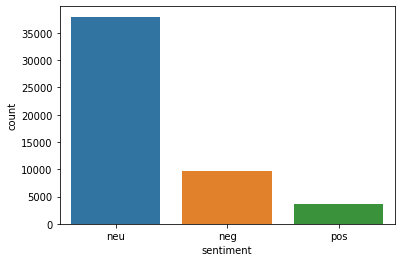

In [ ]:
sns.countplot(df_ab[df_ab.stance=='FAVOR']['sentiment'])

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



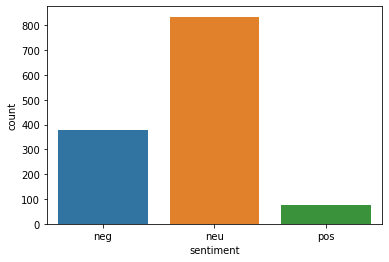

In [ ]:
sns.countplot(df_ab[df_ab.stance=='AGAINST']['sentiment'])

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



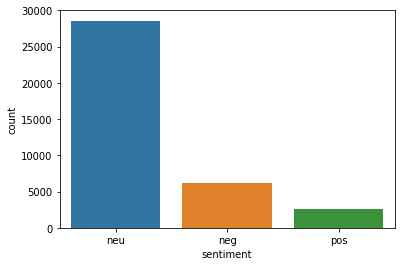

In [ ]:
sns.countplot(df_ab[df_ab.stance=='NONE']['sentiment'])

#target="fauci"

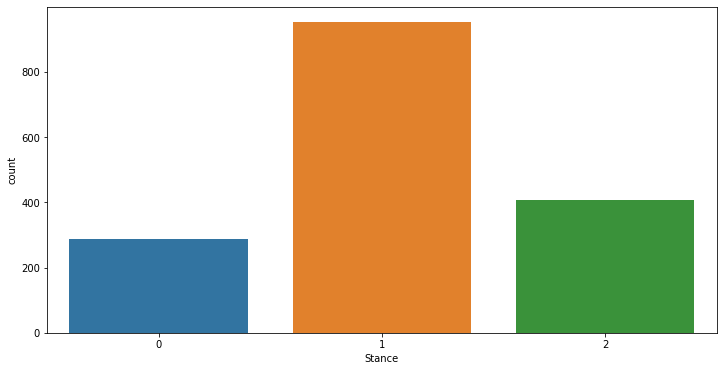

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(x='Stance',data=data3)

In [ ]:
class_0 = data3[data3['Stance'] == 0]#against
class_1 = data3[data3['Stance'] == 1]#favor
class_2 = data3[data3['Stance'] == 2]#none

print('class 0:', class_0.shape)
print('class 1:', class_1.shape)
print('class 2:', class_2.shape)

class 0: (286, 6)
class 1: (952, 6)
class 2: (407, 6)


In [ ]:
token_lens = []
for txt in data3.tweet:
    tokens = tokenizer.encode(txt, max_length=512)
    token_lens.append(len(tokens))


Text(0.5, 0, 'Token count')

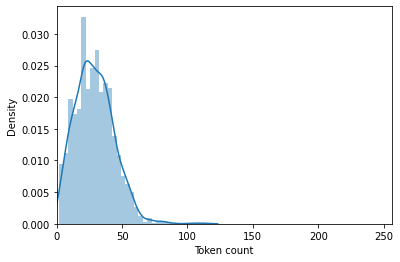

In [ ]:
sns.distplot(token_lens)
plt.xlim([0, 256]);
plt.xlabel('Token count')

In [ ]:
MAX_LEN=130

In [ ]:
from sklearn.model_selection import train_test_split
train, val = train_test_split(
  data3,
  test_size=0.3,
  random_state=RANDOM_SEED
)
test, val = train_test_split(
  val,
  test_size=0.8,
  random_state=RANDOM_SEED
)

In [ ]:
BATCH_SIZE = 32
train_data_loader = create_data_loader(train, tokenizer, MAX_LEN, BATCH_SIZE)
val_data_loader = create_data_loader(val, tokenizer, MAX_LEN, BATCH_SIZE)
test_data_loader = create_data_loader(test, tokenizer, MAX_LEN, BATCH_SIZE)

In [ ]:
df = next(iter(train_data_loader))
df.keys()

dict_keys(['tweet', 'input_ids', 'attention_mask', 'Stance'])

In [ ]:
model = StanceClassifier(3)
model = model.to(device)

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
input_ids = df['input_ids'].to(device)
attention_mask = df['attention_mask'].to(device)

In [ ]:
input_ids=torch.tensor(input_ids)

In [ ]:
F.softmax(model(input_ids, attention_mask),dim=1)

tensor([[0.3212, 0.1437, 0.5351],
        [0.4553, 0.1614, 0.3833],
        [0.3121, 0.2118, 0.4761],
        [0.2864, 0.1400, 0.5736],
        [0.3614, 0.2557, 0.3829],
        [0.2761, 0.1992, 0.5247],
        [0.3785, 0.2089, 0.4126],
        [0.3079, 0.1758, 0.5163],
        [0.3538, 0.2093, 0.4369],
        [0.2407, 0.1882, 0.5712],
        [0.2812, 0.1962, 0.5225],
        [0.3975, 0.2389, 0.3636],
        [0.2527, 0.1001, 0.6471],
        [0.2166, 0.1944, 0.5890],
        [0.2451, 0.1929, 0.5620],
        [0.1967, 0.1526, 0.6507],
        [0.1789, 0.2086, 0.6125],
        [0.3088, 0.2607, 0.4305],
        [0.3561, 0.2420, 0.4019],
        [0.3124, 0.1709, 0.5167],
        [0.3409, 0.2035, 0.4556],
        [0.3550, 0.1939, 0.4511],
        [0.3594, 0.1907, 0.4500],
        [0.2628, 0.1902, 0.5470],
        [0.2860, 0.2734, 0.4406],
        [0.2885, 0.2112, 0.5003],
        [0.2834, 0.1891, 0.5274],
        [0.2674, 0.1280, 0.6047],
        [0.2685, 0.1506, 0.5809],
        [0.336

In [ ]:
model.parameters

<bound method Module.parameters of StanceClassifier(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0): BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768

In [ ]:
#change the learning rate, nb of epochs 
EPOCHS = 10
optimizer = AdamW(model.parameters(), lr=2e-5, correct_bias=False)
total_steps = len(train_data_loader) * EPOCHS
scheduler = get_linear_schedule_with_warmup(
  optimizer,
  num_warmup_steps=0,
  num_training_steps=total_steps
)
weights=torch.FloatTensor([3.32867133,1,2.339]).cuda()
loss_fn = nn.CrossEntropyLoss(weights).to(device)

In [ ]:
%%time
history = defaultdict(list)
best_accuracy = 0
for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}/{EPOCHS}')
    print('-' * 10)
    train_acc, train_loss = train_epoch(model,train_data_loader,loss_fn,optimizer,device,scheduler,len(train))
    print(f'Train loss {train_loss} accuracy {train_acc}')

    val_acc, val_loss = eval_model(model,val_data_loader,loss_fn,device,len(val))
    print(f'Val   loss {val_loss} accuracy {val_acc}')
    print()
    history['train_acc'].append(train_acc)
    history['train_loss'].append(train_loss)
    history['val_acc'].append(val_acc)
    history['val_loss'].append(val_loss)
    if val_acc > best_accuracy:
      torch.save(model.state_dict(), 'best_model_state.bin')
      best_accuracy = val_acc

Epoch 1/10
----------
Train loss 1.107782284418742 accuracy 0.35360556038227625
Val   loss 1.1100178498488207 accuracy 0.23232323232323235

Epoch 2/10
----------
Train loss 1.0891795953114827 accuracy 0.4561251086012163
Val   loss 1.0820345145005446 accuracy 0.29545454545454547

Epoch 3/10
----------
Train loss 0.9770014484723409 accuracy 0.4865334491746307
Val   loss 1.0066533088684082 accuracy 0.5353535353535354

Epoch 4/10
----------
Train loss 0.7679234155350261 accuracy 0.6333622936576889
Val   loss 1.2016413120123057 accuracy 0.5808080808080809

Epoch 5/10
----------
Train loss 0.5188922468158934 accuracy 0.7567332754126845
Val   loss 1.12104293016287 accuracy 0.6515151515151516

Epoch 6/10
----------
Train loss 0.3624206284681956 accuracy 0.8288444830582102
Val   loss 1.058759556366847 accuracy 0.7222222222222223

Epoch 7/10
----------
Train loss 0.20403608452114794 accuracy 0.9183318853171155
Val   loss 1.136743256678948 accuracy 0.7146464646464648

Epoch 8/10
----------
Train 

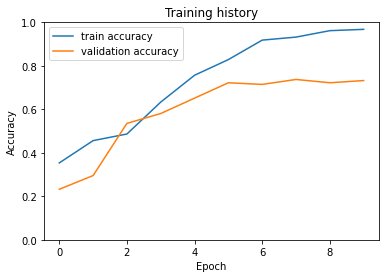

In [ ]:
import matplotlib.pyplot as plt
a = []
b=[]
for i in range(0,10):
    # change a = a.append(i) to    
    a.append(history['train_acc'][i].cpu().item())
    b.append(history['val_acc'][i].cpu().item())
plt.plot(a, label='train accuracy')
plt.plot(b, label='validation accuracy')
plt.title('Training history')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.ylim([0, 1]);

In [ ]:
test_acc, _ = eval_model(
  model,
  test_data_loader,
  loss_fn,
  device,
  len(test)
)
test_acc.item()

0.6938775510204082

In [ ]:
y_review_texts, y_pred, y_pred_probs, y_test = get_predictions(
  model,
  test_data_loader
)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred, target_names=classes))

              precision    recall  f1-score   support

     AGAINST       0.56      0.47      0.51        19
       FAVOR       0.73      0.74      0.73        54
        NONE       0.70      0.76      0.73        25

    accuracy                           0.69        98
   macro avg       0.66      0.66      0.66        98
weighted avg       0.69      0.69      0.69        98



In [ ]:
tweets=df_rostom['tweet']

In [ ]:
liste=[]
liste2=[]
for i in tweets:
      encoded_review = tokenizer.encode_plus(i,max_length=MAX_LEN,add_special_tokens=True,
                                           return_token_type_ids=False,pad_to_max_length=True,return_attention_mask=True,
                                           return_tensors='pt')
      input_ids = encoded_review['input_ids'].to(device)
      attention_mask = encoded_review['attention_mask'].to(device)
      output = model(input_ids, attention_mask)
      _, prediction = torch.max(output, dim=1)
      liste.append(i)
      liste2.append(classes[prediction])

In [ ]:
d = {'tweet':liste,'stance':liste2,'emotion':df_rostom.emotion}
df_rs=pd.DataFrame(d)
df_rs['emotion'] = df_rs['emotion'].replace(np.nan, 'N')

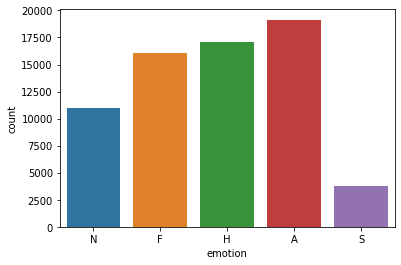

In [ ]:
sns.countplot(df_rs[df_rs.stance=='FAVOR']['emotion'])

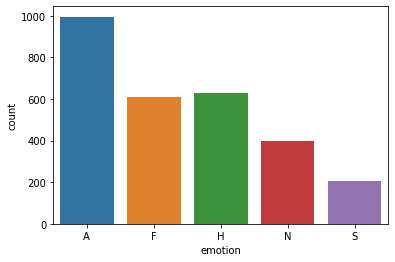

In [ ]:
sns.countplot(df_rs[df_rs.stance=='AGAINST']['emotion'])

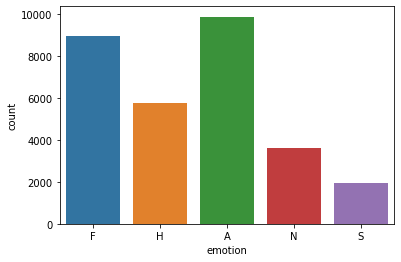

In [ ]:
sns.countplot(df_rs[df_rs.stance=='NONE']['emotion'])

In [ ]:
tweets=df_abhishek['tweet']

In [ ]:
liste=[]
liste2=[]
for i in tweets:
      encoded_review = tokenizer.encode_plus(i,max_length=MAX_LEN,add_special_tokens=True,
                                           return_token_type_ids=False,pad_to_max_length=True,return_attention_mask=True,
                                           return_tensors='pt')
      input_ids = encoded_review['input_ids'].to(device)
      attention_mask = encoded_review['attention_mask'].to(device)
      output = model(input_ids, attention_mask)
      _, prediction = torch.max(output, dim=1)
      liste.append(i)
      liste2.append(classes[prediction])

/usr/local/lib/python3.8/dist-packages/transformers/tokenization_utils_base.py:2336: FutureWarning:

The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).



In [ ]:
d = {'tweet':liste,'stance':liste2,'sentiment':df_abhishek['label']}
df_ab=pd.DataFrame(d)
df_ab

,tweet,stance,sentiment
0,Coronavirus | Human Coronavirus Types | CDC ht...,FAVOR,neu
1,"@shehryar_taseer That‚Äôs üíØ true , \nCorona...",FAVOR,neu
2,"TLDR: Not SARS, possibly new coronavirus. Diff...",FAVOR,neg
3,Disease outbreak news from the WHO: Middle Eas...,FAVOR,neu
4,China - Media: WSJ says sources tell them myst...,FAVOR,neu
...,...,...,...
89995,@C_Racing48 The flu has a 2% death rate.. the ...,FAVOR,neu
89996,@realDonaldTrump We already know that but you‚...,NONE,neg
89997,First coronavirus case reported in St. Joseph ...,FAVOR,neu
89998,"If you ate ants when you were a child, you‚Äôr...",FAVOR,neu


/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



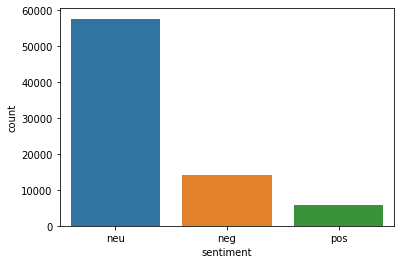

In [ ]:
sns.countplot(df_ab[df_ab.stance=='FAVOR']['sentiment'])

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



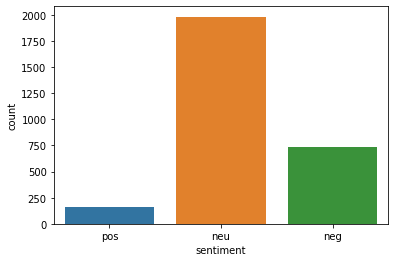

In [ ]:
sns.countplot(df_ab[df_ab.stance=='AGAINST']['sentiment'])

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



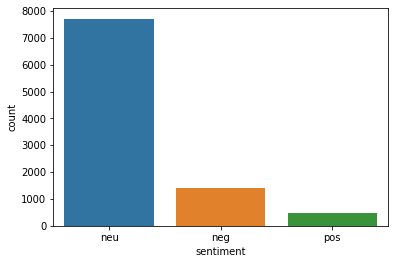

In [ ]:
sns.countplot(df_ab[df_ab.stance=='NONE']['sentiment'])

#target="masks"

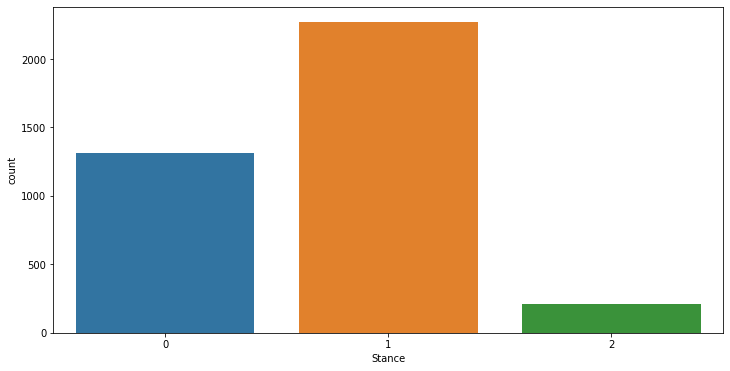

In [ ]:
plt.figure(figsize=(12,6))
sns.countplot(x='Stance',data=data4)

In [ ]:
class_0 = data4[data4['Stance'] == 0]#against
class_1 = data4[data4['Stance'] == 1]#favor
class_2 = data4[data4['Stance'] == 2]#none

print('class 0:', class_0.shape)
print('class 1:', class_1.shape)
print('class 2:', class_2.shape)

class 0: (1314, 6)
class 1: (2269, 6)
class 2: (207, 6)


In [ ]:
token_lens = []
for txt in data4.tweet:
    tokens = tokenizer.encode(txt, max_length=512)
    token_lens.append(len(tokens))

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.


Text(0.5, 0, 'Token count')

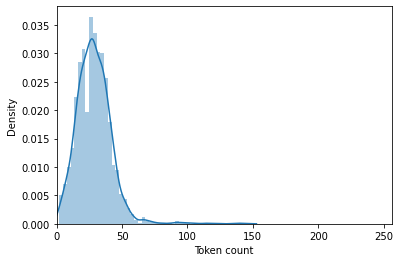

In [ ]:
sns.distplot(token_lens)
plt.xlim([0, 256]);
plt.xlabel('Token count')

In [ ]:
MAX_LEN=152

In [ ]:
from sklearn.model_selection import train_test_split
train, val = train_test_split(
  data4,
  test_size=0.3,
  random_state=RANDOM_SEED
)
test, val = train_test_split(
  val,
  test_size=0.8,
  random_state=RANDOM_SEED
)

In [ ]:
BATCH_SIZE = 32
train_data_loader = create_data_loader(train, tokenizer, MAX_LEN, BATCH_SIZE)
val_data_loader = create_data_loader(val, tokenizer, MAX_LEN, BATCH_SIZE)
test_data_loader = create_data_loader(test, tokenizer, MAX_LEN, BATCH_SIZE)

In [ ]:
df = next(iter(train_data_loader))
df.keys()

dict_keys(['tweet', 'input_ids', 'attention_mask', 'Stance'])

In [ ]:
model = StanceClassifier(3)
model = model.to(device)

Downloading:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
input_ids = df['input_ids'].to(device)
attention_mask = df['attention_mask'].to(device)

In [ ]:
input_ids=torch.tensor(input_ids)

In [ ]:
F.softmax(model(input_ids, attention_mask),dim=1)

tensor([[0.2768, 0.3532, 0.3700],
        [0.2404, 0.5830, 0.1766],
        [0.2869, 0.5173, 0.1958],
        [0.2857, 0.4997, 0.2145],
        [0.3031, 0.4768, 0.2202],
        [0.2212, 0.4467, 0.3321],
        [0.2232, 0.4261, 0.3508],
        [0.2975, 0.5340, 0.1685],
        [0.2193, 0.4967, 0.2840],
        [0.3015, 0.5520, 0.1465],
        [0.2966, 0.5168, 0.1866],
        [0.3319, 0.3219, 0.3463],
        [0.2458, 0.5389, 0.2153],
        [0.3179, 0.4551, 0.2270],
        [0.3679, 0.4223, 0.2097],
        [0.2530, 0.4932, 0.2538],
        [0.3047, 0.4091, 0.2862],
        [0.3335, 0.4615, 0.2050],
        [0.3065, 0.5040, 0.1895],
        [0.3071, 0.4782, 0.2148],
        [0.2685, 0.5263, 0.2052],
        [0.2438, 0.4151, 0.3412],
        [0.2694, 0.4216, 0.3090],
        [0.3948, 0.3971, 0.2081],
        [0.1942, 0.5291, 0.2767],
        [0.3851, 0.3940, 0.2208],
        [0.2172, 0.3809, 0.4019],
        [0.2889, 0.4560, 0.2551],
        [0.2633, 0.5370, 0.1997],
        [0.252

In [ ]:
model.parameters

<bound method Module.parameters of StanceClassifier(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0): BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768

In [ ]:
#change the learning rate, nb of epochs 
EPOCHS = 10
optimizer = AdamW(model.parameters(), lr=2e-5, correct_bias=False)
total_steps = len(train_data_loader) * EPOCHS
scheduler = get_linear_schedule_with_warmup(
  optimizer,
  num_warmup_steps=0,
  num_training_steps=total_steps
)
weights=torch.FloatTensor([1.72,1,10.96]).cuda()
loss_fn = nn.CrossEntropyLoss(weights).to(device)

In [ ]:
%%time
history = defaultdict(list)
best_accuracy = 0
for epoch in range(EPOCHS):
    print(f'Epoch {epoch + 1}/{EPOCHS}')
    print('-' * 10)
    train_acc, train_loss = train_epoch(model,train_data_loader,loss_fn,optimizer,device,scheduler,len(train))
    print(f'Train loss {train_loss} accuracy {train_acc}')

    val_acc, val_loss = eval_model(model,val_data_loader,loss_fn,device,len(val))
    print(f'Val   loss {val_loss} accuracy {val_acc}')
    print()
    history['train_acc'].append(train_acc)
    history['train_loss'].append(train_loss)
    history['val_acc'].append(val_acc)
    history['val_loss'].append(val_loss)
    if val_acc > best_accuracy:
      torch.save(model.state_dict(), 'best_model_state.bin')
      best_accuracy = val_acc

Epoch 1/10
----------
Train loss 0.9144238251519491 accuracy 0.6215604975499435
Val   loss 0.7466356672089676 accuracy 0.7791208791208791

Epoch 2/10
----------
Train loss 0.664759280092745 accuracy 0.8179419525065963
Val   loss 0.5384907270299977 accuracy 0.8494505494505494

Epoch 3/10
----------
Train loss 0.5022896003561566 accuracy 0.8443271767810027
Val   loss 0.44908366917536174 accuracy 0.856043956043956

Epoch 4/10
----------
Train loss 0.3553565659795899 accuracy 0.8993592159819073
Val   loss 0.4682718212234563 accuracy 0.8703296703296703

Epoch 5/10
----------
Train loss 0.24145851728607373 accuracy 0.9295137580098003
Val   loss 0.5640241818438316 accuracy 0.8934065934065935

Epoch 6/10
----------
Train loss 0.1496455133555973 accuracy 0.9615529589144365
Val   loss 0.6066693734249164 accuracy 0.9

Epoch 7/10
----------
Train loss 0.10362351224028382 accuracy 0.9724839803995478
Val   loss 0.68926005675618 accuracy 0.9043956043956044

Epoch 8/10
----------
Train loss 0.05362835

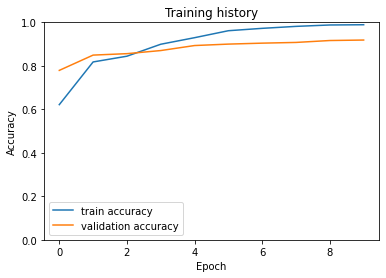

In [ ]:

a = []
b=[]
for i in range(0,10):
    # change a = a.append(i) to    
    a.append(history['train_acc'][i].cpu().item())
    b.append(history['val_acc'][i].cpu().item())
plt.plot(a, label='train accuracy')
plt.plot(b, label='validation accuracy')
plt.title('Training history')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend()
plt.ylim([0, 1]);

In [ ]:
test_acc, _ = eval_model(
  model,
  test_data_loader,
  loss_fn,
  device,
  len(test)
)
test_acc.item()

0.933920704845815

In [ ]:
y_review_texts, y_pred, y_pred_probs, y_test = get_predictions(
  model,
  test_data_loader
)

In [ ]:

print(classification_report(y_test, y_pred, target_names=classes))

              precision    recall  f1-score   support

     AGAINST       0.94      0.90      0.92        80
       FAVOR       0.96      0.97      0.96       136
        NONE       0.67      0.73      0.70        11

    accuracy                           0.93       227
   macro avg       0.85      0.87      0.86       227
weighted avg       0.93      0.93      0.93       227



In [ ]:
tweets=df_rostom['tweet']

In [ ]:
liste=[]
liste2=[]
for i in tweets:
      encoded_review = tokenizer.encode_plus(i,max_length=MAX_LEN,add_special_tokens=True,
                                           return_token_type_ids=False,pad_to_max_length=True,return_attention_mask=True,
                                           return_tensors='pt')
      input_ids = encoded_review['input_ids'].to(device)
      attention_mask = encoded_review['attention_mask'].to(device)
      output = model(input_ids, attention_mask)
      _, prediction = torch.max(output, dim=1)
      liste.append(i)
      liste2.append(classes[prediction])

In [ ]:
d = {'tweet':liste,'stance':liste2,'emotion':df_rostom['emotion']}
df_rs=pd.DataFrame(d)
df_rs['emotion'] = df_rs['emotion'].replace(np.nan, 'N')

In [ ]:
df_rs

,tweet,stance,emotion
0,Covid-19 restrictions extended to travellers f...,FAVOR,NaN
1,"Best guess, worst case scenario US #COVID-19: ...",FAVOR,F
2,@Vampiric_Kai I have enough with Corona infect...,FAVOR,F
3,@Firatondr german doner with corona :D,AGAINST,H
4,The Diamond Princess cruise ship quarantine li...,FAVOR,F
...,...,...,...
99995,Look after yourselves and everyone else. Coron...,FAVOR,A
99996,The number of cases of COVID-19 has surpassed ...,NONE,H
99997,LeadingAge Colorado will continue to support a...,NONE,H
99998,@jonlovett putting Pence in charge of corona v...,NONE,F


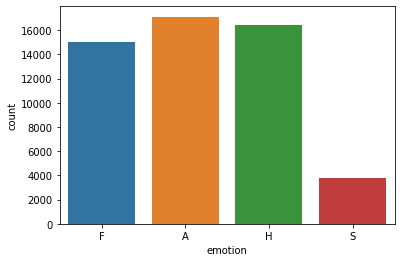

In [ ]:
sns.countplot(df_rs[df_rs.stance=='FAVOR']['emotion'])

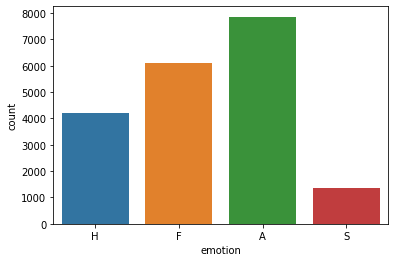

In [ ]:
sns.countplot(df_rs[df_rs.stance=='AGAINST']['emotion'])

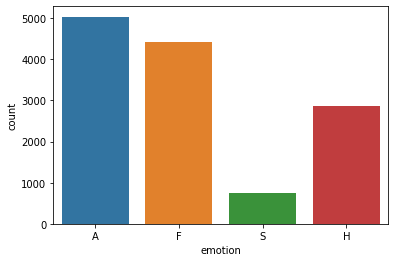

In [ ]:
sns.countplot(df_rs[df_rs.stance=='NONE']['emotion'])

In [ ]:
tweets=df_abhishek['tweet']

In [ ]:
liste=[]
liste2=[]
for i in tweets:
      encoded_review = tokenizer.encode_plus(i,max_length=MAX_LEN,add_special_tokens=True,
                                           return_token_type_ids=False,pad_to_max_length=True,return_attention_mask=True,
                                           return_tensors='pt')
      input_ids = encoded_review['input_ids'].to(device)
      attention_mask = encoded_review['attention_mask'].to(device)
      output = model(input_ids, attention_mask)
      _, prediction = torch.max(output, dim=1)
      liste.append(i)
      liste2.append(classes[prediction])

In [ ]:
d = {'tweet':liste,'stance':liste2,'sentiment':df_abhishek.label}
df_ab=pd.DataFrame(d)
df_ab

,tweet,stance,sentiment
0,Coronavirus | Human Coronavirus Types | CDC ht...,FAVOR,neu
1,"@shehryar_taseer That‚Äôs üíØ true , \nCorona...",FAVOR,neu
2,"TLDR: Not SARS, possibly new coronavirus. Diff...",AGAINST,neg
3,Disease outbreak news from the WHO: Middle Eas...,FAVOR,neu
4,China - Media: WSJ says sources tell them myst...,FAVOR,neu
...,...,...,...
89995,@C_Racing48 The flu has a 2% death rate.. the ...,FAVOR,neu
89996,@realDonaldTrump We already know that but you‚...,NONE,neg
89997,First coronavirus case reported in St. Joseph ...,FAVOR,neu
89998,"If you ate ants when you were a child, you‚Äôr...",AGAINST,neu


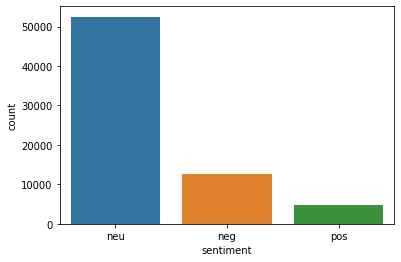

In [ ]:
sns.countplot(df_ab[df_ab.stance=='FAVOR']['sentiment'])

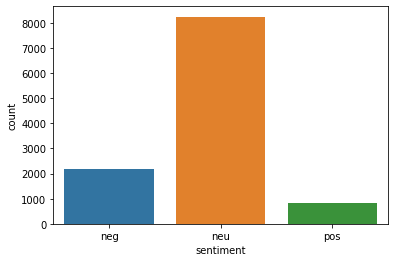

In [ ]:
sns.countplot(df_ab[df_ab.stance=='AGAINST']['sentiment'])

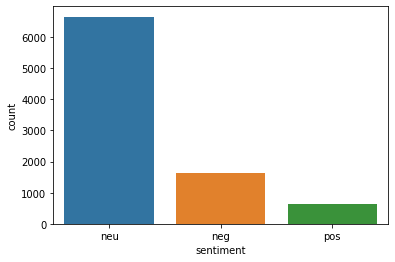

In [ ]:
sns.countplot(df_ab[df_ab.stance=='NONE']['sentiment'])